In [56]:
%load_ext autoreload 
%autoreload 2

In [61]:
from watermark_utils import load_model, decode_message_pil, decode_message, eval_message
from utils_img import jpeg_compress

In [60]:
import torch
import fire
from PIL import Image
import torch
import torchvision.transforms as transforms
import numpy as np

from skimage.metrics import peak_signal_noise_ratio, structural_similarity
import lpips

import augly
import augly.image.functional as augfunc


In [10]:
DEVICE = 0
INPATH = "cat.no_wm.png"
SAVEPATH = "cat.wma.png"

In [11]:
device = torch.device("cuda", DEVICE)
pipe = load_model(device, use_watermarked=True)

Loading pipeline components...: 100%|██████████████████████████████████████████████████████████████████████| 6/6 [00:01<00:00,  5.59it/s]


>>> Building LDM model with config sd/stable-diffusion-2-1-base/v2-inference.yaml and weights from sd/stable-diffusion-2-1-base/v2-1_512-ema-pruned.ckpt...
Loading model from sd/stable-diffusion-2-1-base/v2-1_512-ema-pruned.ckpt
Global Step: 220000
LatentDiffusion: Running in eps-prediction mode
DiffusionWrapper has 865.91 M params.
making attention of type 'vanilla' with 512 in_channels
Working with z of shape (1, 4, 32, 32) = 4096 dimensions.
making attention of type 'vanilla' with 512 in_channels
_IncompatibleKeys(missing_keys=['encoder.conv_in.weight', 'encoder.conv_in.bias', 'encoder.down.0.block.0.norm1.weight', 'encoder.down.0.block.0.norm1.bias', 'encoder.down.0.block.0.conv1.weight', 'encoder.down.0.block.0.conv1.bias', 'encoder.down.0.block.0.norm2.weight', 'encoder.down.0.block.0.norm2.bias', 'encoder.down.0.block.0.conv2.weight', 'encoder.down.0.block.0.conv2.bias', 'encoder.down.0.block.1.norm1.weight', 'encoder.down.0.block.1.norm1.bias', 'encoder.down.0.block.1.conv1.wei

decoding message
Extracted message:  111010110101000001010111010011010100010000100111
decoded message: [True, True, True, False, True, False, True, True, False, True, False, True, False, False, False, False, False, True, False, True, False, True, True, True, False, True, False, False, True, True, False, True, False, True, False, False, False, True, False, False, False, False, True, False, False, True, True, True]
Bit accuracy:  1.0
p-value of statistical test:  BinomTestResult(k=48, n=48, alternative='greater', proportion_estimate=1.0, pvalue=3.552713678800501e-15)
PSNR: 31.44904402827499, SSIM: 0.8699608897517556


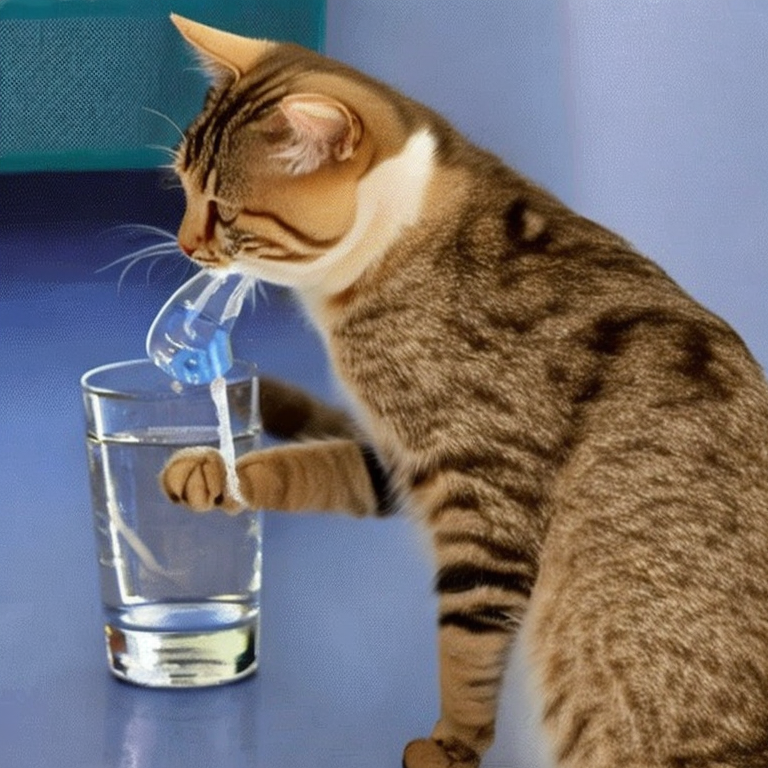

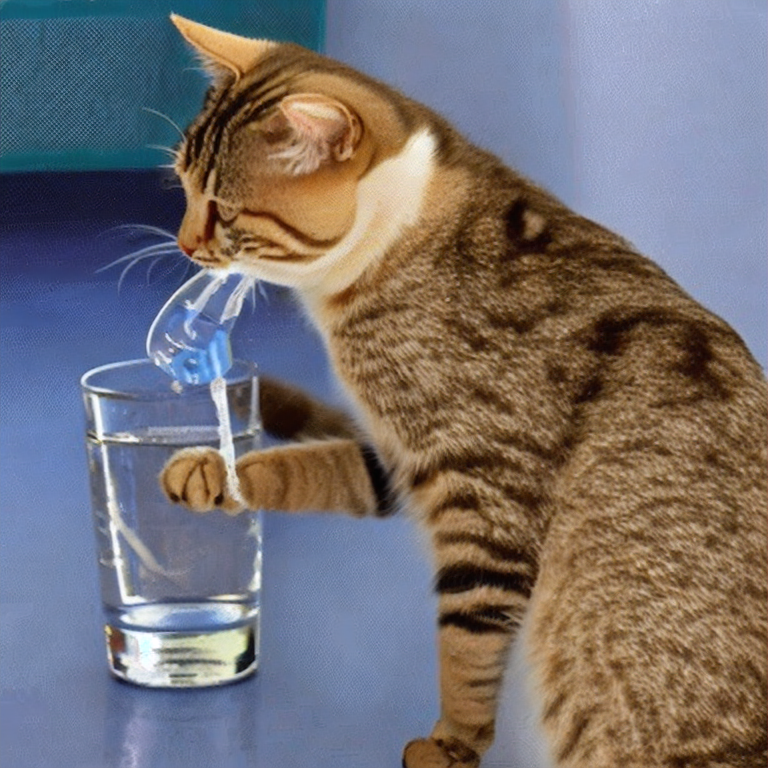

In [19]:
img = Image.open(INPATH)
orig_img = img
img = (transforms.ToTensor()(img) - 0.5)/0.5
img = img.unsqueeze(0).to(device)

with torch.no_grad():
    z = pipe.vae.encode(img)
    reimg = pipe.vae.decode(z.latent_dist.mode())[0]
    reimg = reimg[0] * 0.5 + 0.5

print("decoding message")
reimg = transforms.ToPILImage()(reimg.clamp(0, 1))
msg = decode_message_pil(reimg)
print(f"decoded message: {msg}")
eval_message(msg)

psnr = peak_signal_noise_ratio(np.asarray(orig_img), np.asarray(reimg))
ssim = structural_similarity(np.asarray(orig_img), np.asarray(reimg), channel_axis=2)
print(f"PSNR: {psnr}, SSIM: {ssim}")

display(orig_img, reimg)




In [22]:
print(reimg.size)

(768, 768)


# Play around with perturbations

## Crop and rescale

decoding message
applying perturbations
Extracted message:  111010110001111001010010011011110100001001100110
decoded message: [True, True, True, False, True, False, True, True, False, False, False, True, True, True, True, False, False, True, False, True, False, False, True, False, False, True, True, False, True, True, True, True, False, True, False, False, False, False, True, False, False, True, True, False, False, True, True, False]
Bit accuracy:  0.75
p-value of statistical test:  BinomTestResult(k=36, n=48, alternative='greater', proportion_estimate=0.75, pvalue=0.00035863483669729146)
PSNR: 13.088623964865018, SSIM: 0.3051026693957377


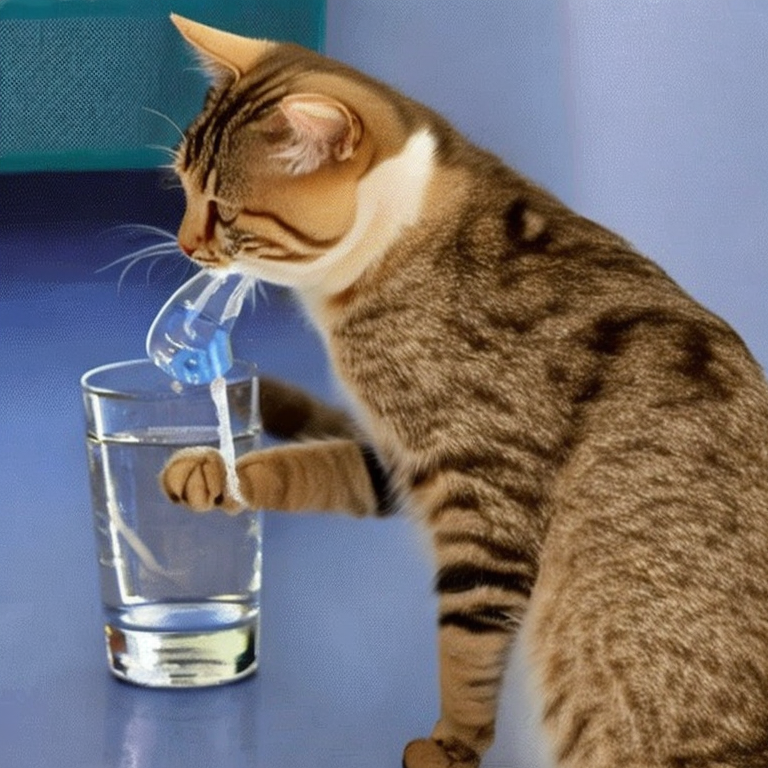

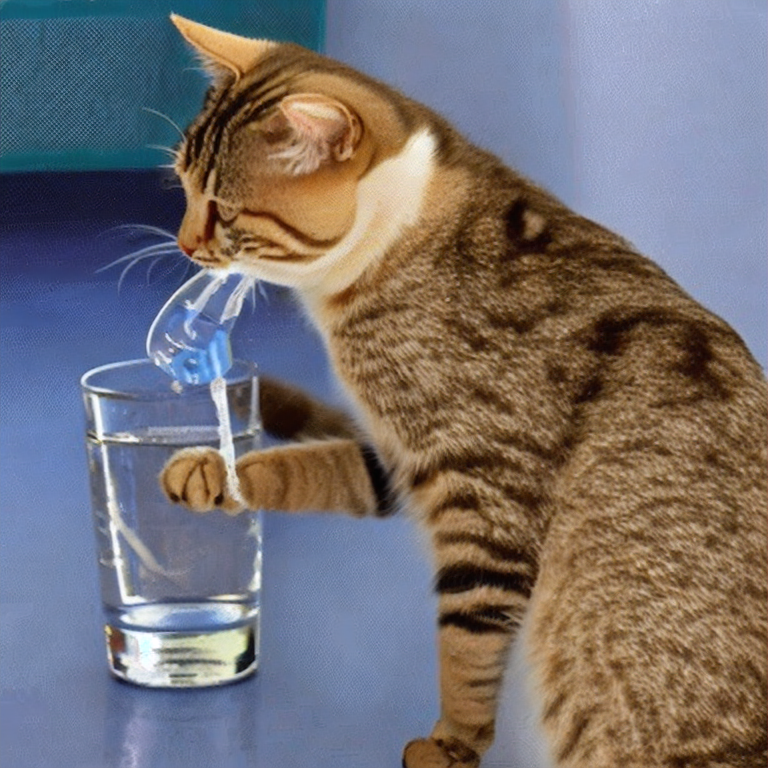

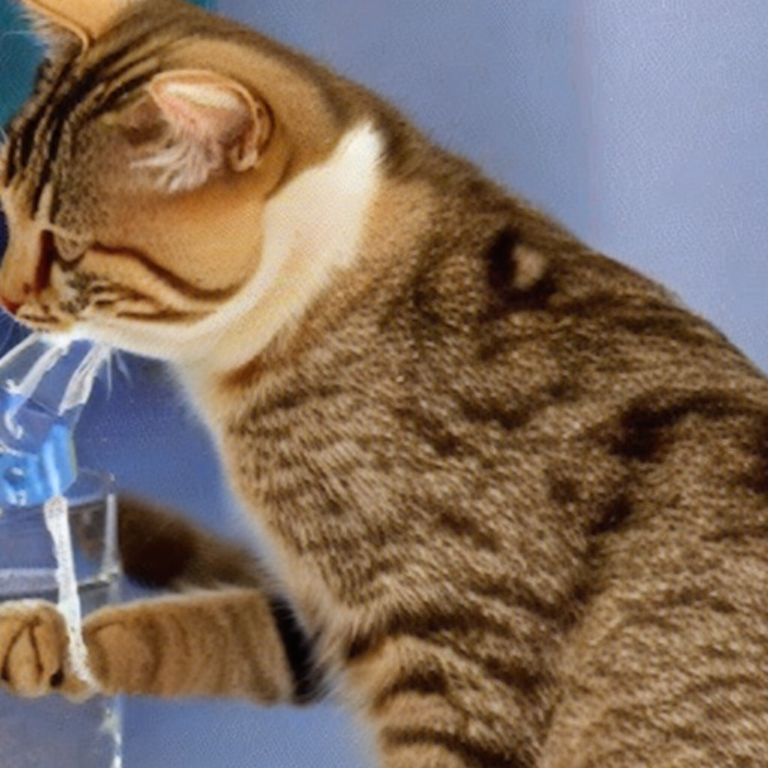

In [23]:
img = Image.open(INPATH)
orig_img = img
img = (transforms.ToTensor()(img) - 0.5)/0.5
img = img.unsqueeze(0).to(device)

with torch.no_grad():
    z = pipe.vae.encode(img)
    reimg = pipe.vae.decode(z.latent_dist.mode())[0]
    reimg = reimg[0] * 0.5 + 0.5

print("decoding message")
reimg = transforms.ToPILImage()(reimg.clamp(0, 1))

perturbed_reimg = reimg
perturbed_reimg = transforms.RandomCrop(size=(512, 512))(perturbed_reimg)
perturbed_reimg = transforms.Resize(size=(768, 768))(perturbed_reimg)

print("applying perturbations")

msg = decode_message_pil(perturbed_reimg)
print(f"decoded message: {msg}")
eval_message(msg)

psnr = peak_signal_noise_ratio(np.asarray(orig_img), np.asarray(perturbed_reimg))
ssim = structural_similarity(np.asarray(orig_img), np.asarray(perturbed_reimg), channel_axis=2)
print(f"PSNR: {psnr}, SSIM: {ssim}")

display(orig_img, reimg, perturbed_reimg)




## Gaussian Blur

decoding message
applying perturbations
Extracted message:  111000100000100011111010111001010100001011111111
decoded message: [True, True, True, False, False, False, True, False, False, False, False, False, True, False, False, False, True, True, True, True, True, False, True, False, True, True, True, False, False, True, False, True, False, True, False, False, False, False, True, False, True, True, True, True, True, True, True, True]
Bit accuracy:  0.6041666666666667
p-value of statistical test:  BinomTestResult(k=29, n=48, alternative='greater', proportion_estimate=0.6041666666666666, pvalue=0.09670632643096869)
PSNR: 30.847170963528285, SSIM: 0.8250167039283868


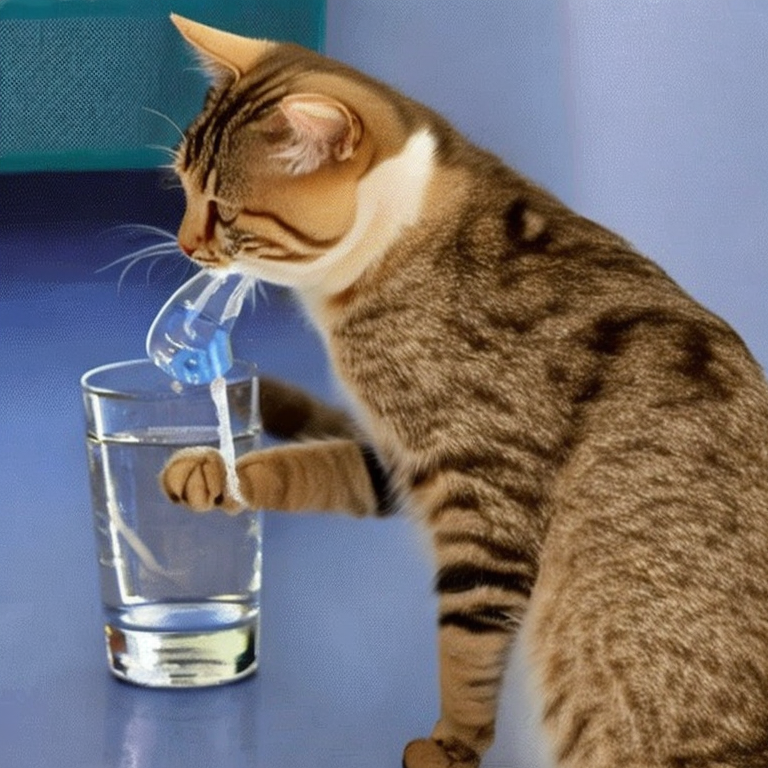

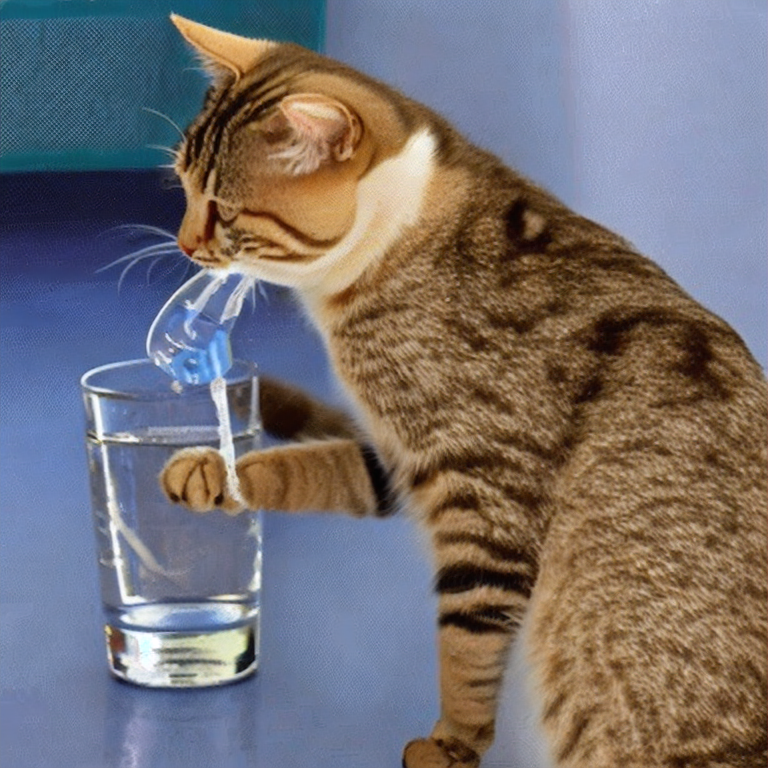

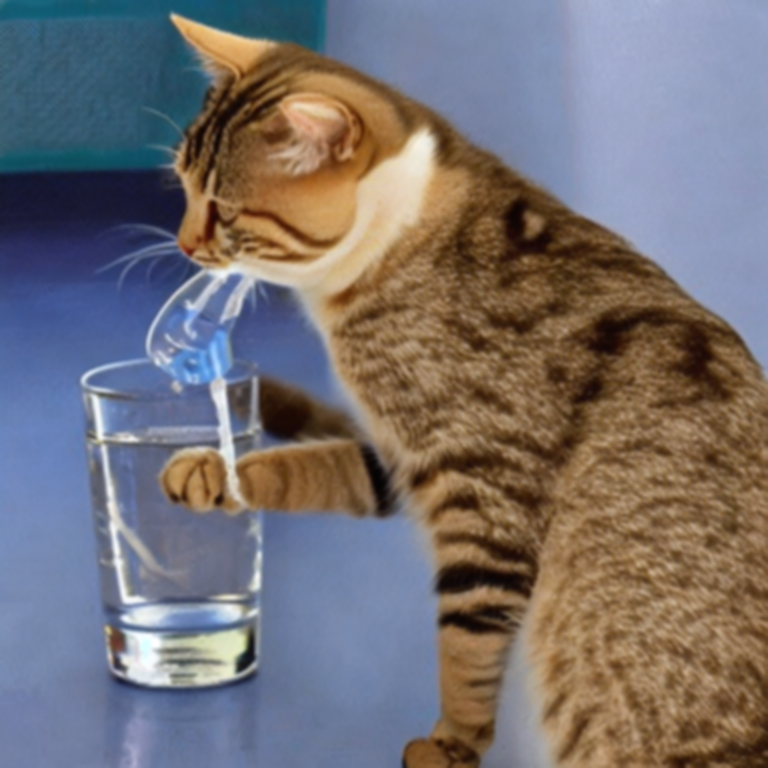

In [28]:
img = Image.open(INPATH)
orig_img = img
img = (transforms.ToTensor()(img) - 0.5)/0.5
img = img.unsqueeze(0).to(device)

with torch.no_grad():
    z = pipe.vae.encode(img)
    reimg = pipe.vae.decode(z.latent_dist.mode())[0]
    reimg = reimg[0] * 0.5 + 0.5

print("decoding message")
reimg = transforms.ToPILImage()(reimg.clamp(0, 1))

perturbed_reimg = reimg
perturbed_reimg = transforms.GaussianBlur(kernel_size=5, sigma=(2.))(perturbed_reimg)

print("applying perturbations")

msg = decode_message_pil(perturbed_reimg)
print(f"decoded message: {msg}")
eval_message(msg)

psnr = peak_signal_noise_ratio(np.asarray(orig_img), np.asarray(perturbed_reimg))
ssim = structural_similarity(np.asarray(orig_img), np.asarray(perturbed_reimg), channel_axis=2)
print(f"PSNR: {psnr}, SSIM: {ssim}")

display(orig_img, reimg, perturbed_reimg)




In [29]:
def add_gaussian_noise_pil(x, noise_level=0.05):
    x = transforms.ToTensor()(x)
    x = x + torch.randn_like(x) * noise_level
    x = transforms.ToPILImage()(x.clamp(0, 1))
    return x

## Gaussian Blur + JPEG + Gaussian Noise 

decoding message
applying perturbations
Extracted message:  111110010001110000101011000001100111000011001101
decoded message: [True, True, True, True, True, False, False, True, False, False, False, True, True, True, False, False, False, False, True, False, True, False, True, True, False, False, False, False, False, True, True, False, False, True, True, True, False, False, False, False, True, True, False, False, True, True, False, True]
Bit accuracy:  0.5416666666666667
p-value of statistical test:  BinomTestResult(k=26, n=48, alternative='greater', proportion_estimate=0.5416666666666666, pvalue=0.3327329060383094)
(768, 768)
PSNR: 26.174886695072438, SSIM: 0.5087172153293674


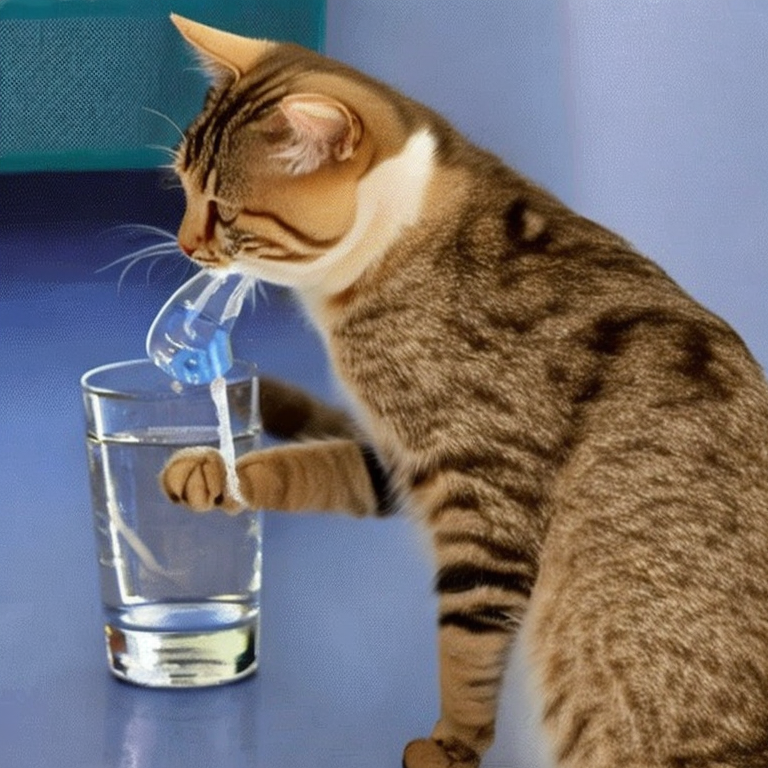

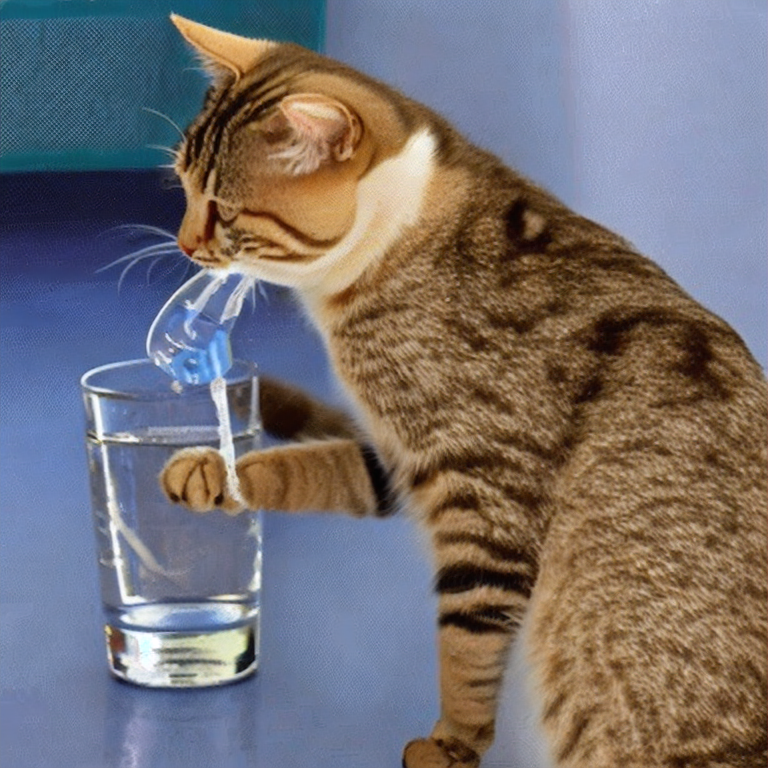

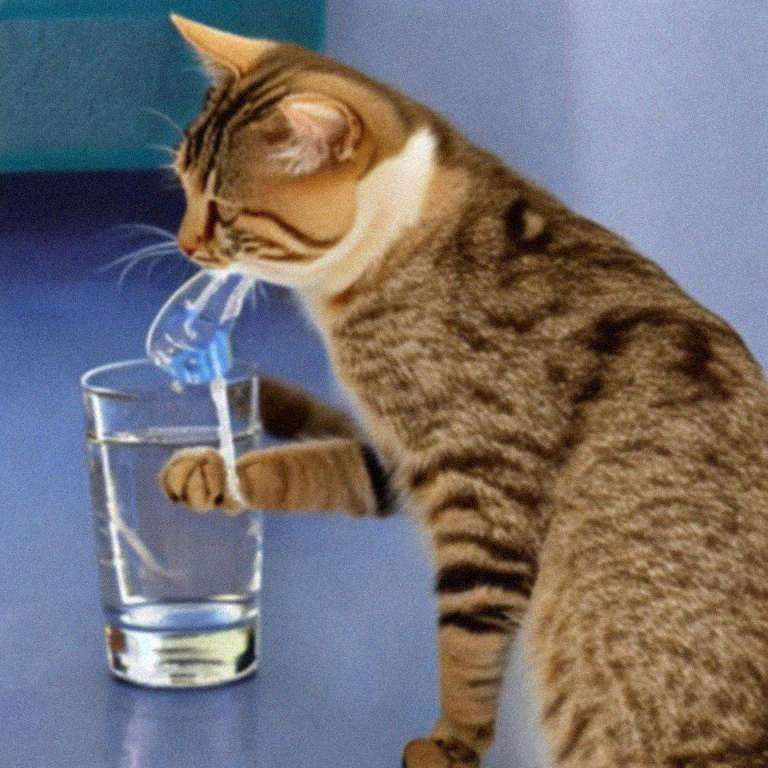

In [85]:
img = Image.open(INPATH)
orig_img = img
img = (transforms.ToTensor()(img) - 0.5)/0.5
img = img.unsqueeze(0).to(device)

with torch.no_grad():
    z = pipe.vae.encode(img)
    reimg = pipe.vae.decode(z.latent_dist.mode())[0]
    reimg = reimg[0] * 0.5 + 0.5

print("decoding message")
reimg = transforms.ToPILImage()(reimg.clamp(0, 1))

perturbed_reimg = reimg
perturbed_reimg = transforms.GaussianBlur(kernel_size=5, sigma=(1.5))(perturbed_reimg)
perturbed_reimg = augfunc.encoding_quality(perturbed_reimg, quality=75)
perturbed_reimg = add_gaussian_noise_pil(perturbed_reimg, noise_level=0.04)

print("applying perturbations")

msg = decode_message_pil(perturbed_reimg)
print(f"decoded message: {msg}")
eval_message(msg)

print(orig_img.size)

psnr = peak_signal_noise_ratio(np.asarray(orig_img), np.asarray(perturbed_reimg))
ssim = structural_similarity(np.asarray(orig_img), np.asarray(perturbed_reimg), channel_axis=2)
print(f"PSNR: {psnr}, SSIM: {ssim}")

display(orig_img, reimg, perturbed_reimg)




## Gaussian Blur + JPEG + Gaussian Noise + LPIPS

In [118]:
from torch.autograd import Variable

def optimize_lpips(pred, ref, net="vgg", lr=1e-2, steps=100, psnr_threshold=29., device=torch.device("cpu")):
    
    def to_pil(_img):
        _img = _img[0]
        return transforms.ToPILImage()(_img * 0.5 + 0.5)
    
    loss_fn = lpips.LPIPS(net='vgg')
    ref = transforms.ToTensor()(ref) * 2 - 1
    ref = ref[None]
    
    pred = transforms.ToTensor()(pred) * 2 - 1
    pred = pred[None]
    pred = Variable(pred, requires_grad=True)
    
    loss_fn = loss_fn.to(device)
    ref = ref.to(device)
    pred = pred.to(device)
    
    optimizer = torch.optim.Adam([pred,], lr=lr, betas=(0.9, 0.999))

    for i in range(steps):
        print(f"Step {i}")
        if i % 10 == 0:
            # evaluate PSNR and watermark bits
            psnr = peak_signal_noise_ratio(np.asarray(to_pil(ref)), np.asarray(to_pil(pred)))
            print(f"PSNR: {psnr}")
            msg = decode_message_pil(to_pil(pred))
            eval_message(msg)
        
        optimizer.zero_grad()
        dist = loss_fn.forward(pred, ref)
        dist.backward()
        optimizer.step()
        pred.data = torch.clamp(pred.data, -1, 1)
        
        
    return to_pil(pred)


Original image:


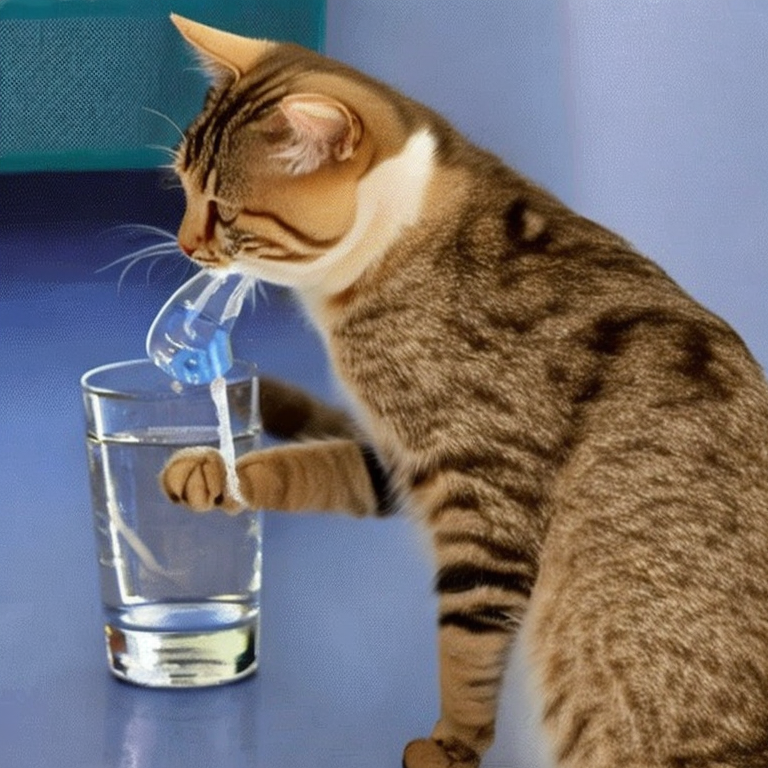

decoding message
Watermarked image:


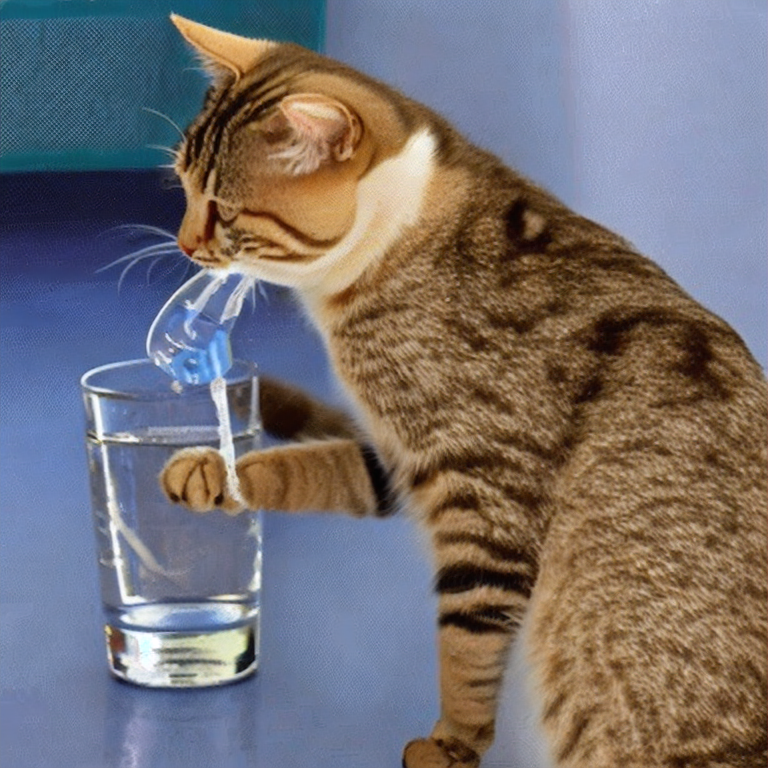

Extracted message:  111010110101000001010111010011010100010000100111
decoded message: [True, True, True, False, True, False, True, True, False, True, False, True, False, False, False, False, False, True, False, True, False, True, True, True, False, True, False, False, True, True, False, True, False, True, False, False, False, True, False, False, False, False, True, False, False, True, True, True]
Bit accuracy:  1.0
p-value of statistical test:  BinomTestResult(k=48, n=48, alternative='greater', proportion_estimate=1.0, pvalue=3.552713678800501e-15)
PSNR: 31.44904402827499, SSIM: 0.8699608897517556
applying perturbations
Perturbed watermarked image:


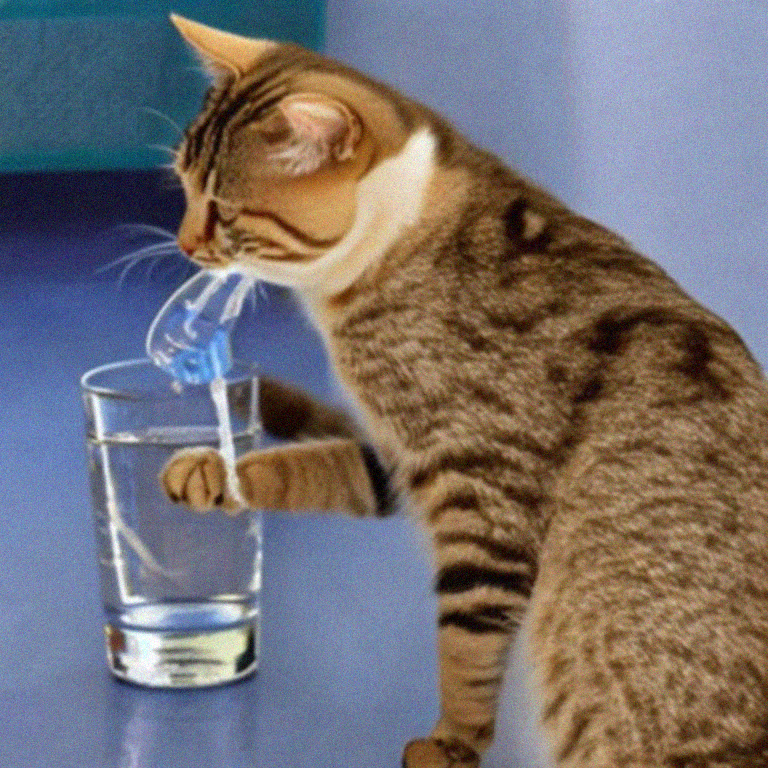

Extracted message:  111111010001110001101001000001100111000011001101
decoded message: [True, True, True, True, True, True, False, True, False, False, False, True, True, True, False, False, False, True, True, False, True, False, False, True, False, False, False, False, False, True, True, False, False, True, True, True, False, False, False, False, True, True, False, False, True, True, False, True]
Bit accuracy:  0.5208333333333333
p-value of statistical test:  BinomTestResult(k=25, n=48, alternative='greater', proportion_estimate=0.5208333333333334, pvalue=0.4427167486432568)
PSNR: 26.18405085831112, SSIM: 0.5097403826597421
Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /USERSPACE/lukovdg1/venvs/stablesignature/lib/python3.9/site-packages/lpips/weights/v0.1/vgg.pth
Step 0
PSNR: 26.485026334475656
Extracted message:  111111010001110001101001000001100111000011001101
Bit accuracy:  0.5208333333333333
p-value of statistical test:  BinomTestResult(

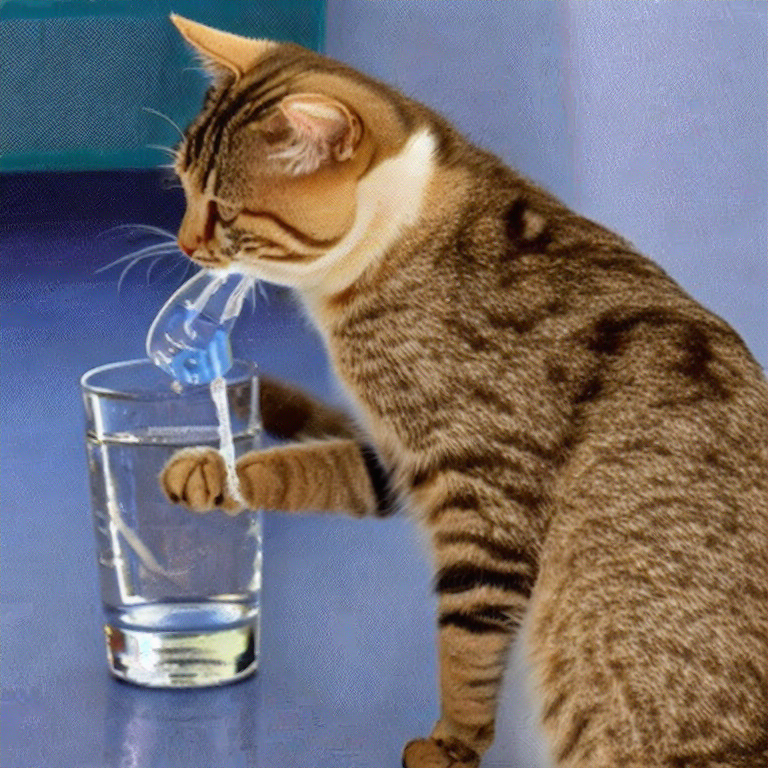

Extracted message:  111010110101000001110011010011010100010000100111
decoded message: [True, True, True, False, True, False, True, True, False, True, False, True, False, False, False, False, False, True, True, True, False, False, True, True, False, True, False, False, True, True, False, True, False, True, False, False, False, True, False, False, False, False, True, False, False, True, True, True]
Bit accuracy:  0.9583333333333334
p-value of statistical test:  BinomTestResult(k=46, n=48, alternative='greater', proportion_estimate=0.9583333333333334, pvalue=4.1815439999481896e-12)
Perturbed vs Watermarked: PSNR: 28.997477184086264, SSIM: 0.711732853727936
Perturbed vs Original: PSNR: 27.393970048740588, SSIM: 0.6339788575741553


In [121]:
img = Image.open(INPATH)
orig_img = img
img = (transforms.ToTensor()(img) - 0.5)/0.5
img = img.unsqueeze(0).to(device)

print("Original image:")
display(orig_img)

with torch.no_grad():
    z = pipe.vae.encode(img)
    reimg = pipe.vae.decode(z.latent_dist.mode())[0]
    reimg = reimg[0] * 0.5 + 0.5

print("decoding message")
reimg = transforms.ToPILImage()(reimg.clamp(0, 1))

print("Watermarked image:")
display(reimg)

# test
msg = decode_message_pil(reimg)
print(f"decoded message: {msg}")
eval_message(msg)

psnr = peak_signal_noise_ratio(np.asarray(orig_img), np.asarray(reimg))
ssim = structural_similarity(np.asarray(orig_img), np.asarray(reimg), channel_axis=2)
print(f"PSNR: {psnr}, SSIM: {ssim}")

# DO PERTURBATIONS #######
print("applying perturbations")
perturbed_reimg = reimg
perturbed_reimg = transforms.GaussianBlur(kernel_size=5, sigma=(1.5))(perturbed_reimg)
perturbed_reimg = augfunc.encoding_quality(perturbed_reimg, quality=75)
perturbed_reimg = add_gaussian_noise_pil(perturbed_reimg, noise_level=0.04)

print("Perturbed watermarked image:")
display(perturbed_reimg)

# test
msg = decode_message_pil(perturbed_reimg)
print(f"decoded message: {msg}")
eval_message(msg)

psnr = peak_signal_noise_ratio(np.asarray(orig_img), np.asarray(perturbed_reimg))
ssim = structural_similarity(np.asarray(orig_img), np.asarray(perturbed_reimg), channel_axis=2)
print(f"PSNR: {psnr}, SSIM: {ssim}")


# DO LPIPS OPTIM ########
perturbed_reimg = optimize_lpips(perturbed_reimg, reimg)

print("LPIPS optimized watermarked image:")
display(perturbed_reimg)

# test
msg = decode_message_pil(perturbed_reimg)
print(f"decoded message: {msg}")
eval_message(msg)

psnr_w = peak_signal_noise_ratio(np.asarray(reimg), np.asarray(perturbed_reimg))
ssim_w = structural_similarity(np.asarray(reimg), np.asarray(perturbed_reimg), channel_axis=2)
print(f"Perturbed vs Watermarked: PSNR: {psnr_w}, SSIM: {ssim_w}")
psnr_o = peak_signal_noise_ratio(np.asarray(orig_img), np.asarray(perturbed_reimg))
ssim_o = structural_similarity(np.asarray(orig_img), np.asarray(perturbed_reimg), channel_axis=2)
print(f"Perturbed vs Original: PSNR: {psnr_o}, SSIM: {ssim_o}")





In [122]:
import loss

ModuleNotFoundError: No module named 'loss'